# PREP

In [1]:
import random
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from wildlifeml.utils.io import (
    load_csv, 
    load_json, 
    load_pickle,
    load_image,
)
from wildlifeml.data import subset_dataset
from wildlifeml.utils.datasets import render_bbox, map_bbox_to_img, separate_empties
from wildlifeml.preprocessing.cropping import Cropper

2023-07-20 08:29:16.895501: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2023-07-20 08:29:19.470783: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2023-07-20 08:29:19.471010: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2023-07-20 08:29:19.512174: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:18:00.0 name: GeForce RTX 2080 Ti computeCapability: 7.5
coreClock: 1.545GHz coreCount: 68 deviceMemorySize: 10.76GiB deviceMemoryBandwidth: 573.69GiB/s
2023-07-20 08:29:19.512765: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 1 with properties: 
pciBusID: 0000:3b:00.0 name: GeForce RTX 2080 Ti computeCapability: 7.5
coreClock: 1.545GHz coreCount: 68 deviceMemorySize: 10.76GiB deviceMemoryBandwidth: 573.69GiB/s
2023-

In [3]:
# REPODIR = '/home/wimmerl/projects/wildlife-experiments'
# IMGDIR = '/common/bothmannl/wildlife_images/usecase2/original_images/'
# DATADIR = os.path.join(REPODIR, 'data', 'bavaria', 'md5')
# RESULTDIR = os.path.join(REPODIR, 'results', 'bavaria', 'md5')
REPODIR = '/home/wimmerl/projects/wildlife-experiments'
IMGDIR = '/common/bothmannl/wildlife_images/channel_islands/channel_islands_images/'
DATADIR = os.path.join(REPODIR, 'data', 'channel_islands')
RESULTDIR = os.path.join(REPODIR, 'results', 'channel_islands')
CFG = load_json(os.path.join(REPODIR, 'configs/cfg.json'))

In [4]:
LABEL_MAP = load_json(os.path.join(DATADIR, 'label_map_names.json'))
LABEL_DICT = {k: v for k, v in load_csv(os.path.join(DATADIR, CFG['label_file']))}
MAPPING_DICT = load_json(os.path.join(DATADIR, CFG['mapping_file']))
DETECTOR_DICT = load_json(os.path.join(DATADIR, CFG['detector_file']))
META_DF = pd.read_csv(os.path.join(DATADIR, 'metadata.csv'))

# DESCRIPTIVE

## STATS

In [5]:
STATIONS_SPLIT = load_json(os.path.join(DATADIR, 'stations_split.json'))

In [8]:
BBOX_MAP = load_json(os.path.join(DATADIR, 'bbox_map.json'))

In [9]:
META_DF = META_DF.loc[~META_DF['true_class'].isin([1, 6])]
META_DF = META_DF.loc[META_DF['orig_name'].isin(list(BBOX_MAP.keys()))]

In [10]:
META_DF.loc[META_DF['station'].isin(STATIONS_SPLIT['STATIONS_IS'])].groupby(['true_class'])['orig_name'].count()

true_class
0    14445
2     4147
3       37
4     1397
5      210
Name: orig_name, dtype: int64

In [66]:
META_DF.loc[META_DF['station'].isin(STATIONS_SPLIT['STATIONS_OOS'])].groupby(['true_class'])['orig_name'].count()

true_class
empty            14274
european_hare      255
others            1051
red_deer           135
red_fox            106
red_squirrel        13
roe_deer          7010
wild_boar          904
Name: orig_name, dtype: int64

In [12]:
stations_used = set(META_DF['station'])

In [6]:
len(set(STATIONS_SPLIT['STATIONS_IS']) & stations_used), len(set(STATIONS_SPLIT['STATIONS_OOS']) & stations_used)

(37, 36)

In [101]:
oos_test = load_pickle(os.path.join(DATADIR, 'dataset_oos_test.pkl'))
len(oos_test.keys)

3677

In [112]:
len(set(oos_test.keys) & set([k for k, v in DETECTOR_DICT.items() if v['category'] != -1]))

1503

In [110]:
DETECTOR_DICT

{'10348_I_00202c.JPG_001': {'category': -1,
  'file': '/common/bothmannl/wildlife_images/usecase2/original_images/10348_I_00202c.JPG'},
 '72_I_00082c.JPG_001': {'category': 0,
  'conf': 0.3262,
  'bbox': [0.8331, 0.4823, 0.08699, 0.1408],
  'file': '/common/bothmannl/wildlife_images/usecase2/original_images/72_I_00082c.JPG'},
 '4023_01030647.JPG_001': {'category': -1,
  'file': '/common/bothmannl/wildlife_images/usecase2/original_images/4023_01030647.JPG'},
 '20803_I_00416a.JPG_001': {'category': 0,
  'conf': 0.9642,
  'bbox': [0.118, 0.216, 0.1396, 0.2373],
  'file': '/common/bothmannl/wildlife_images/usecase2/original_images/20803_I_00416a.JPG'},
 '10037_11160357.JPG_001': {'category': -1,
  'file': '/common/bothmannl/wildlife_images/usecase2/original_images/10037_11160357.JPG'},
 '10107_I_00292b.JPG_001': {'category': 0,
  'conf': 0.9739,
  'bbox': [0.1991, 0.3765, 0.2868, 0.5488],
  'file': '/common/bothmannl/wildlife_images/usecase2/original_images/10107_I_00292b.JPG'},
 '51483_12

In [107]:
len(set([k for k, v in BBOX_MAP.items() if len(v) == 1]))

46626

## EXEMPLARY MISCLASSIFIED CASES

In [71]:
results = load_pickle(os.path.join(RESULTDIR, 'passive/10/202306221648_insample_test_123_md5.pkl'))
OUR_THRESH = 0.1

In [72]:
def sort_results(dict_preds, truth):
    ordered_dict = {k: dict_preds[k] for k in sorted(list(dict_preds.keys()))}
    ordered_array = np.concatenate([x.reshape(1, len(LABEL_MAP)) for x in list(ordered_dict.values())])
    ordered_list = [truth[k] for k in [list(dict_preds.keys()).index(i) for i in sorted(list(dict_preds.keys()))]]
    return ordered_array, ordered_list

In [73]:
def inspect_images(
    results, 
    true_label: str, 
    label_map: dict, 
    mapping_dict: dict,
    detector_dict: dict,
    n_displays: int, 
    img_dir: str,
    is_misclassified: bool,
    sorting: str,  # ['asc', 'desc', 'rand'],
    min_conf: float = 0.,
    max_conf: float = 1.
):
    preds_imgs_ppl, truth_imgs_ppl = sort_results(results['preds_imgs_ppl'], results['truth_imgs_ppl'])
    result_ranking = pd.DataFrame(
        zip(
            sorted(list(results['preds_imgs_ppl'].keys())), 
            [np.argmax(v) for v in preds_imgs_ppl],
            [np.max(v) for v in preds_imgs_ppl],
            truth_imgs_ppl,
        ),
        columns=['img', 'pred_label', 'conf', 'true_label']
    )
    result_ranking = result_ranking.loc[result_ranking['true_label'] == label_map[true_label]]
    if is_misclassified:
        result_ranking = result_ranking.loc[result_ranking['pred_label'] != label_map[true_label]]

    if sorting == 'asc':
        img_keys = result_ranking.sort_values('conf')['img'][:n_displays]
    elif sorting == 'desc':
        img_keys = result_ranking.sort_values('conf', ascending=False)['img'][:n_displays]
    else: 
        img_keys = random.sample(list(result_ranking['img']), n_displays)

    result_dict = {}
    for idx, k in enumerate(img_keys):
        pred_class = np.argmax(preds_imgs_ppl[idx, ...])
        bbox_keys = mapping_dict[k]
        fig, ax = plt.subplots()
        ax.set_yticks([])
        ax.set_xticks([])
        img = load_image(os.path.join(img_dir, k))
        width, height = img.size
        x_coords, y_coords = [], []
        for bkey in bbox_keys:
            bbox = detector_dict[bkey].get('bbox')
            if bbox is not None:
                x, y = Cropper.get_absolute_coords(detector_dict[bkey].get('bbox'), (height, width))
                x_coords.append(x)
                y_coords.append(y)
        img = render_bbox(img, x_coords, y_coords)
        ax.imshow(img)
        plt.show()
        plt.close()
        pred_class = result_ranking.loc[result_ranking['img'] == k, 'pred_label'].values[0]
        pred_class_name = [k for k, v in label_map.items() if v == pred_class][0]
        conf = result_ranking.loc[result_ranking['img'] == k]['conf'].item()
        result_dict.update({k: img})
        print(
            f'Image: {k}\nTrue: {true_label}\nPredicted: {pred_class_name}\nConfidence: {conf:.2f}'
        )
    return result_dict

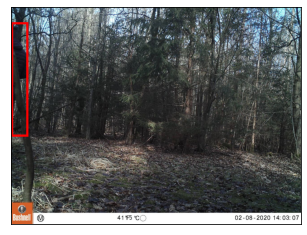

Image: 49379_02080894.JPG
True: empty
Predicted: others
Confidence: 0.99


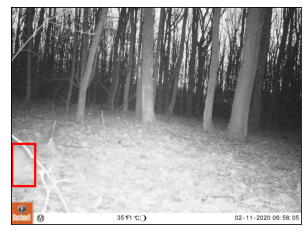

Image: 19007_02110338.JPG
True: empty
Predicted: others
Confidence: 0.92


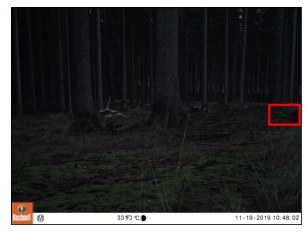

Image: 6160_11190492.JPG
True: empty
Predicted: roe_deer
Confidence: 1.00


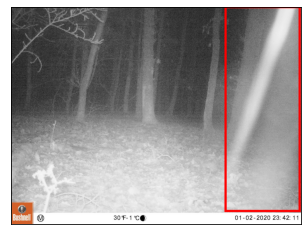

Image: 18530_01020860.JPG
True: empty
Predicted: roe_deer
Confidence: 0.65


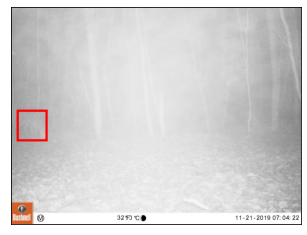

Image: 8135_11210263.JPG
True: empty
Predicted: roe_deer
Confidence: 1.00


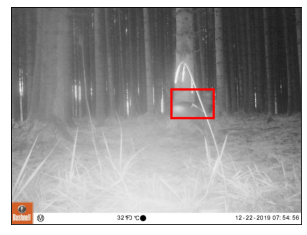

Image: 109198_12220749.JPG
True: empty
Predicted: roe_deer
Confidence: 1.00


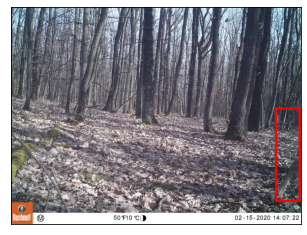

Image: 19045_02150376.JPG
True: empty
Predicted: others
Confidence: 1.00


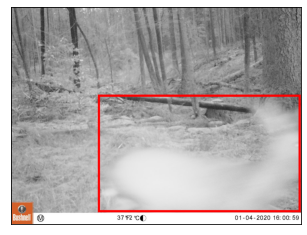

Image: 11611_01040340.JPG
True: empty
Predicted: roe_deer
Confidence: 1.00


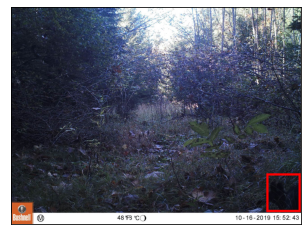

Image: 122023_10160880.JPG
True: empty
Predicted: red_squirrel
Confidence: 0.97


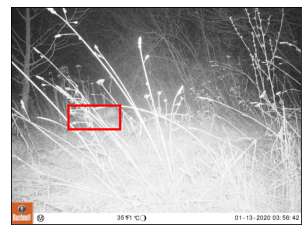

Image: 17318_01130538.JPG
True: empty
Predicted: others
Confidence: 0.99


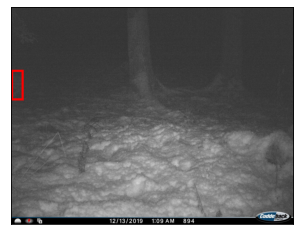

Image: 20248_I_00231a.JPG
True: empty
Predicted: roe_deer
Confidence: 0.98


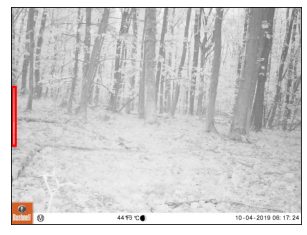

Image: 17738_10040068.JPG
True: empty
Predicted: roe_deer
Confidence: 0.99


In [79]:
random.seed(456)
true_empty = inspect_images(
    results=results, 
    true_label='empty',
    label_map=LABEL_MAP,
    mapping_dict=MAPPING_DICT,
    detector_dict=DETECTOR_DICT,
    n_displays=12,
    img_dir=IMGDIR,
    is_misclassified=True,
    sorting='max'
)

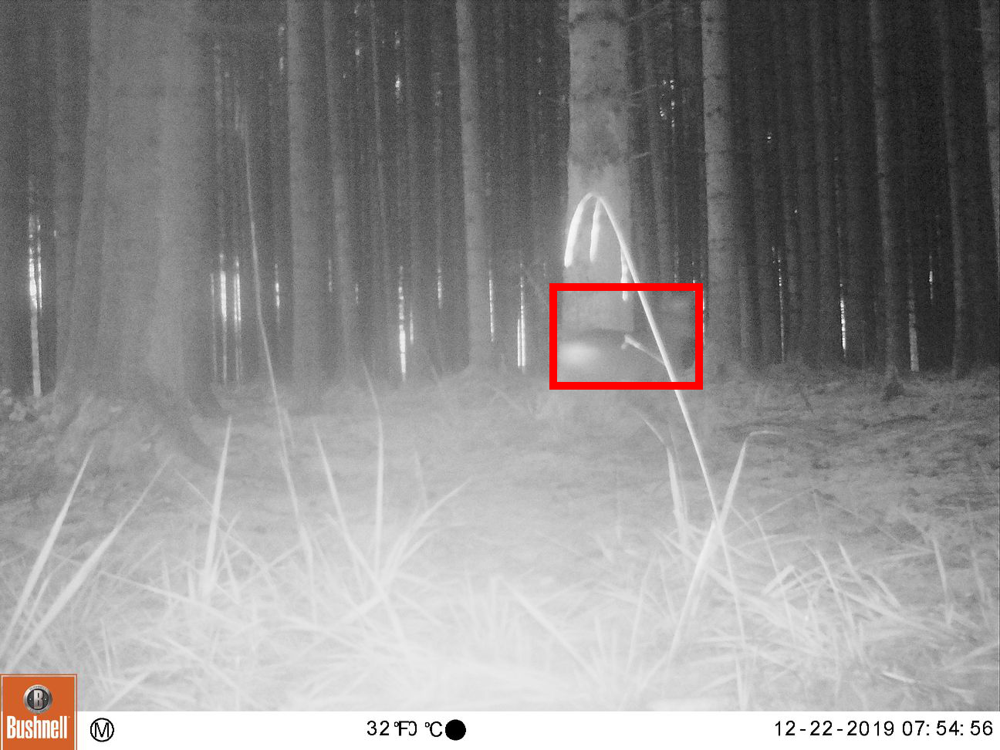

In [80]:
true_empty['109198_12220749.JPG'] # wrong true label

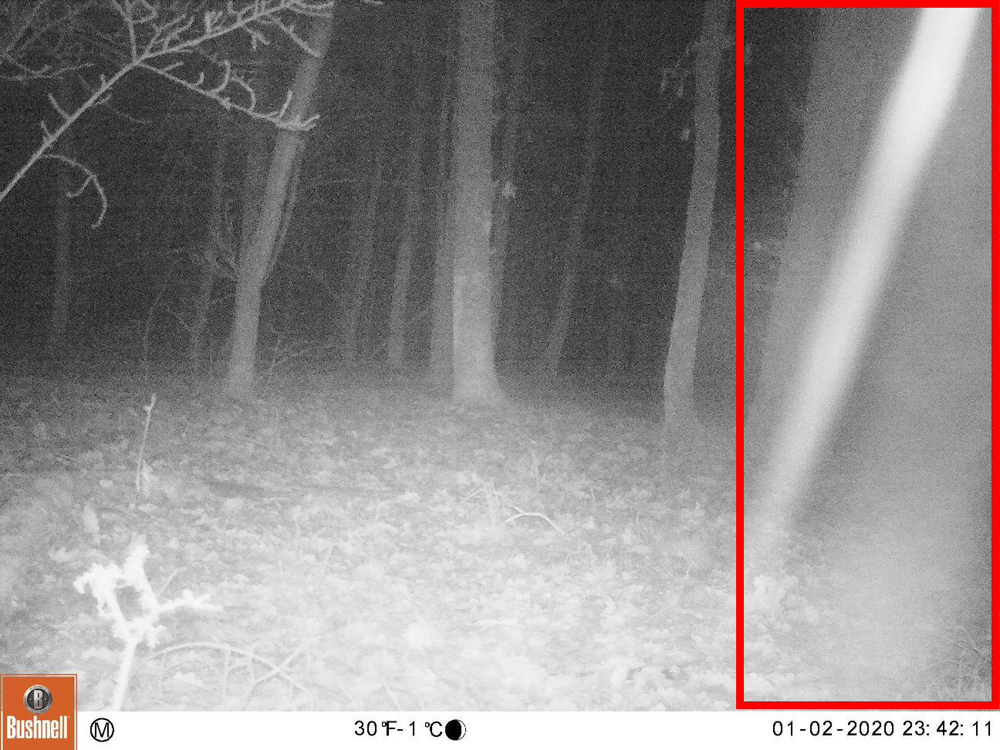

In [81]:
true_empty['18530_01020860.JPG'] # wrong bbox

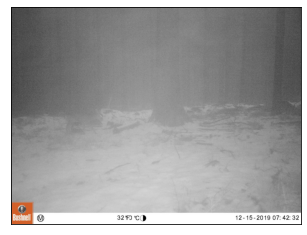

Image: 4620_12150570.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


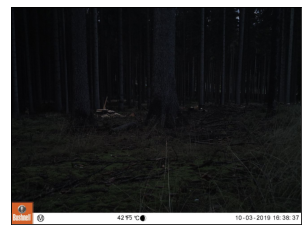

Image: 4721_10030507.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


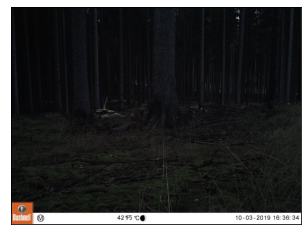

Image: 4350_10030503.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


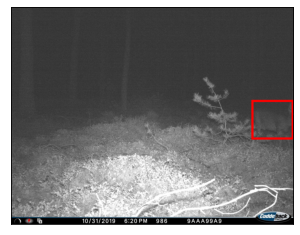

Image: 39434_I_00123a.JPG
True: roe_deer
Predicted: wild_boar
Confidence: 0.94


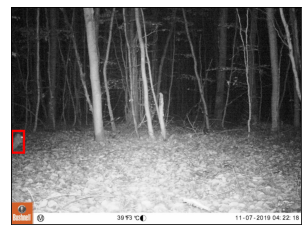

Image: 7907_11070207.JPG
True: roe_deer
Predicted: others
Confidence: 0.76


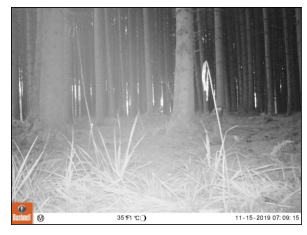

Image: 108990_11150541.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


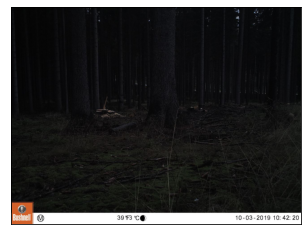

Image: 6308_10030382.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


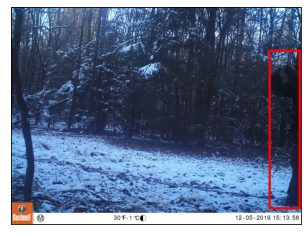

Image: 50173_12050547.JPG
True: roe_deer
Predicted: others
Confidence: 1.00


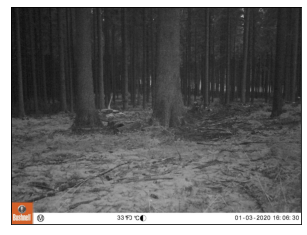

Image: 12362_01030684.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


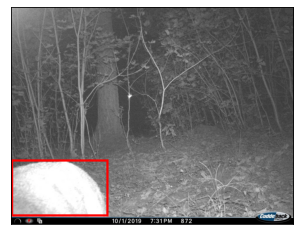

Image: 30995_I_00007b.JPG
True: roe_deer
Predicted: wild_boar
Confidence: 0.47


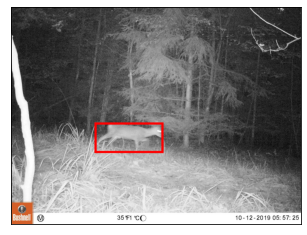

Image: 48430_10120320.JPG
True: roe_deer
Predicted: red_fox
Confidence: 0.86


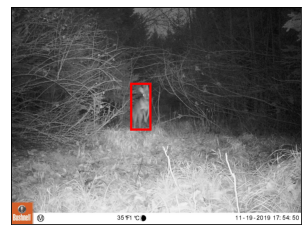

Image: 123586_11190445.JPG
True: roe_deer
Predicted: european_hare
Confidence: 1.00


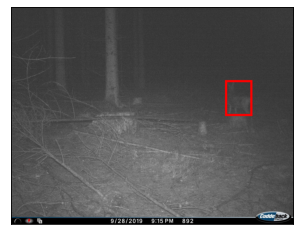

Image: 11045_I_00013b.JPG
True: roe_deer
Predicted: european_hare
Confidence: 0.71


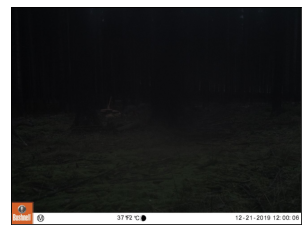

Image: 4831_12210793.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


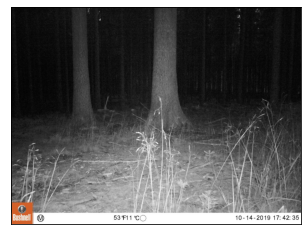

Image: 8731_10140050.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


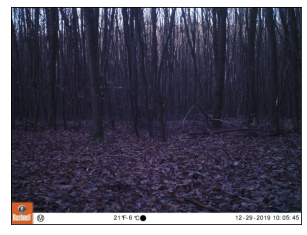

Image: 8294_12290358.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


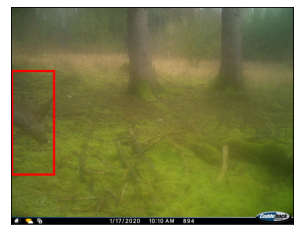

Image: 20560_I_00335a.JPG
True: roe_deer
Predicted: others
Confidence: 0.90


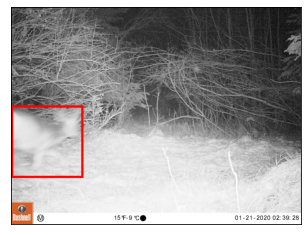

Image: 127150_01210013.JPG
True: roe_deer
Predicted: others
Confidence: 0.94


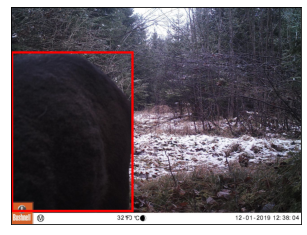

Image: 124189_12010049.JPG
True: roe_deer
Predicted: others
Confidence: 0.74


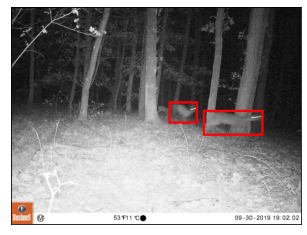

Image: 17635_09300964.JPG
True: roe_deer
Predicted: european_hare
Confidence: 0.50


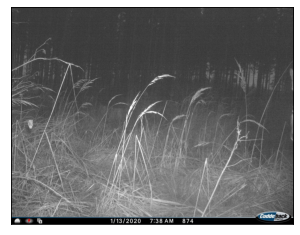

Image: 12_I_00180a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


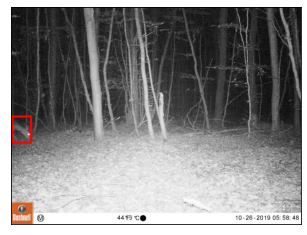

Image: 8550_10260088.JPG
True: roe_deer
Predicted: european_hare
Confidence: 0.90


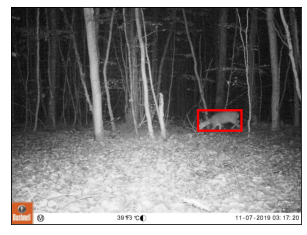

Image: 8530_11070145.JPG
True: roe_deer
Predicted: red_fox
Confidence: 0.79


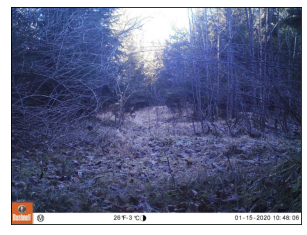

Image: 58014_01150689.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


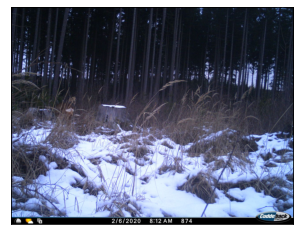

Image: 320_I_00239a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


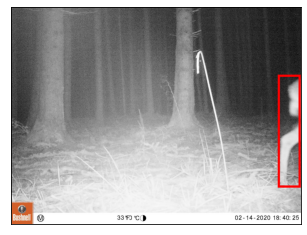

Image: 109660_02140212.JPG
True: roe_deer
Predicted: others
Confidence: 0.67


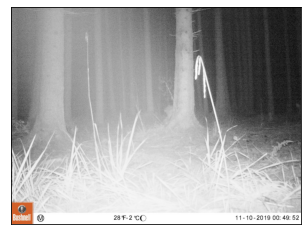

Image: 108929_11100480.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


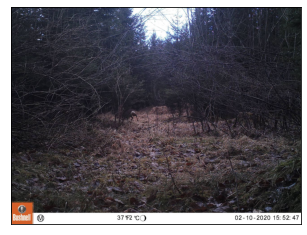

Image: 55779_02100426.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


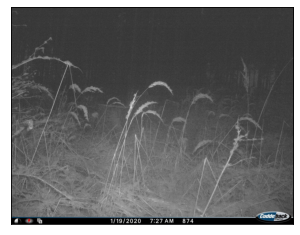

Image: 401_I_00199b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


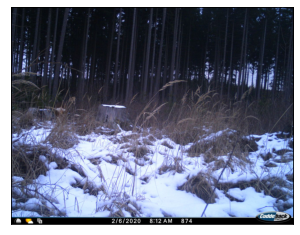

Image: 369_I_00239b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


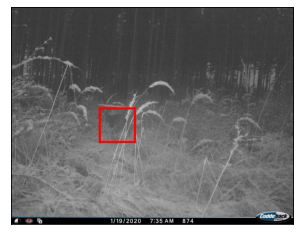

Image: 373_I_00209a.JPG
True: roe_deer
Predicted: empty
Confidence: 0.52


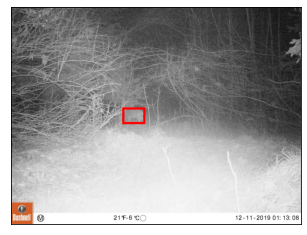

Image: 57067_12110705.JPG
True: roe_deer
Predicted: red_fox
Confidence: 0.98


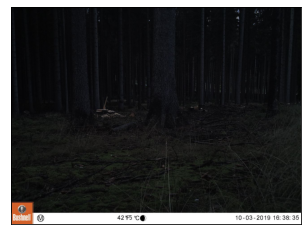

Image: 6875_10030505.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


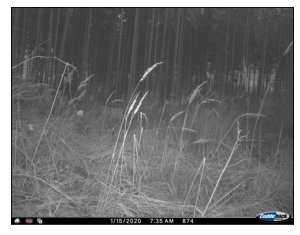

Image: 85_I_00187c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


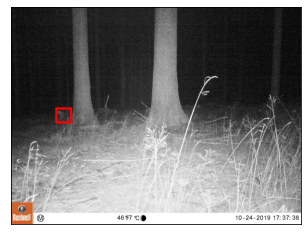

Image: 4375_10240470.JPG
True: roe_deer
Predicted: others
Confidence: 0.42


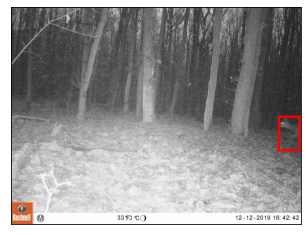

Image: 18307_12120637.JPG
True: roe_deer
Predicted: others
Confidence: 0.79


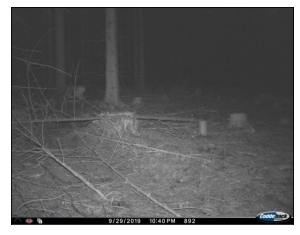

Image: 11219_I_00018c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


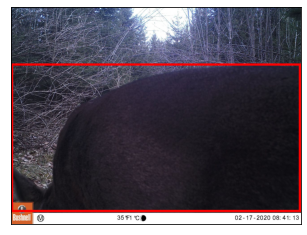

Image: 128891_02170755.JPG
True: roe_deer
Predicted: others
Confidence: 0.99


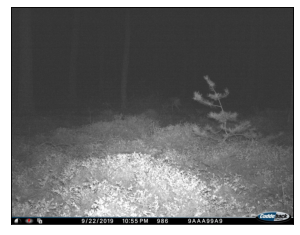

Image: 39573_I_00002a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


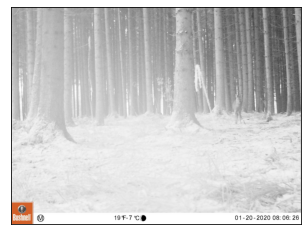

Image: 109423_01200974.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


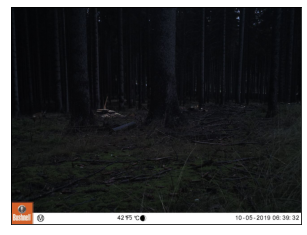

Image: 6184_10050605.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


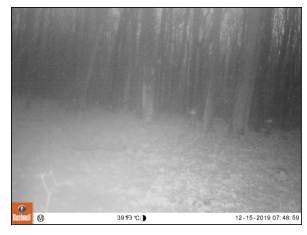

Image: 18341_12150671.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


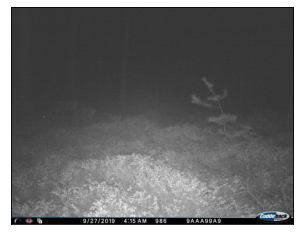

Image: 39506_I_00037c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


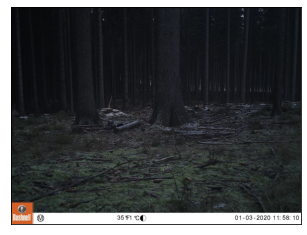

Image: 4992_01030635.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


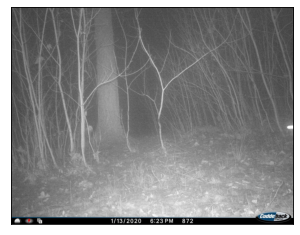

Image: 30870_I_00150c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


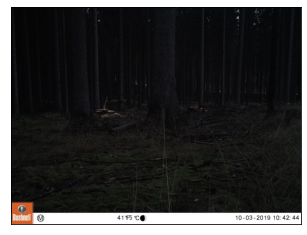

Image: 8069_10030387.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


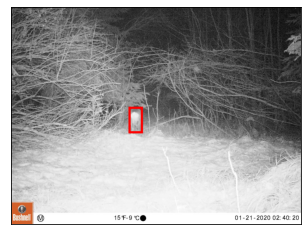

Image: 127153_01210016.JPG
True: roe_deer
Predicted: red_fox
Confidence: 0.64


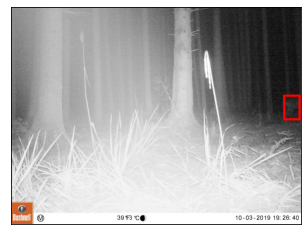

Image: 108467_10030018.JPG
True: roe_deer
Predicted: others
Confidence: 0.52


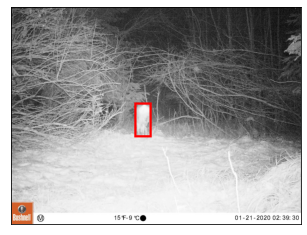

Image: 57933_01210015.JPG
True: roe_deer
Predicted: red_fox
Confidence: 0.98


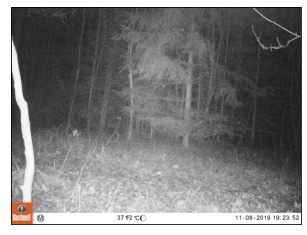

Image: 47050_11080987.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


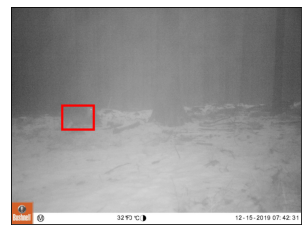

Image: 5979_12150569.JPG
True: roe_deer
Predicted: others
Confidence: 0.60


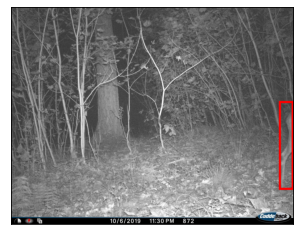

Image: 30643_I_00042b.JPG
True: roe_deer
Predicted: others
Confidence: 0.84


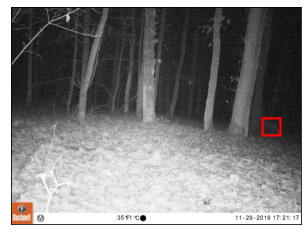

Image: 18163_11290493.JPG
True: roe_deer
Predicted: others
Confidence: 0.37


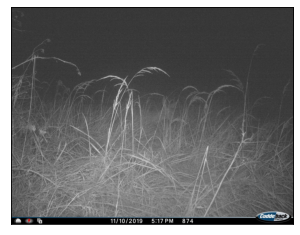

Image: 575_I_00045a.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


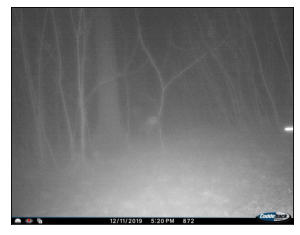

Image: 30778_I_00104c.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


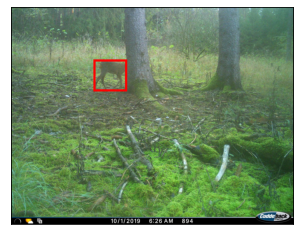

Image: 19673_I_00039b.JPG
True: roe_deer
Predicted: others
Confidence: 0.88


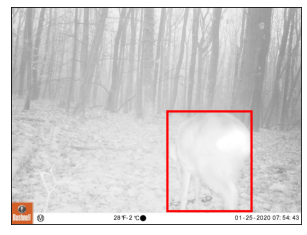

Image: 18791_01250122.JPG
True: roe_deer
Predicted: red_fox
Confidence: 0.45


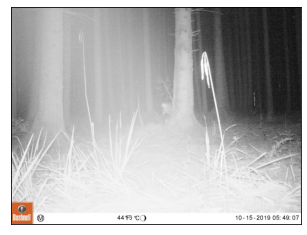

Image: 108623_10150174.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


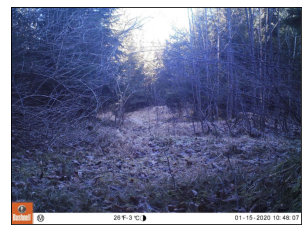

Image: 57132_01150690.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


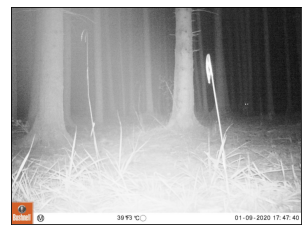

Image: 109326_01090877.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


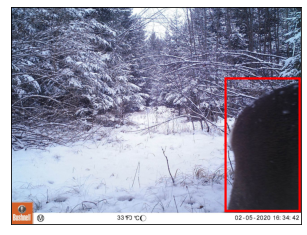

Image: 55723_02050089.JPG
True: roe_deer
Predicted: others
Confidence: 0.95


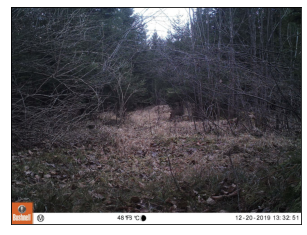

Image: 125460_12200321.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


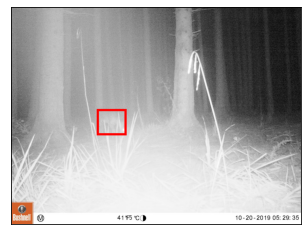

Image: 108697_10200248.JPG
True: roe_deer
Predicted: red_fox
Confidence: 0.72


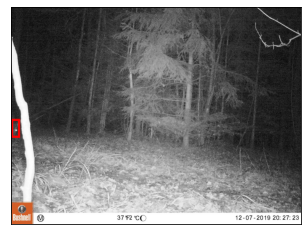

Image: 49363_12070622.JPG
True: roe_deer
Predicted: others
Confidence: 1.00


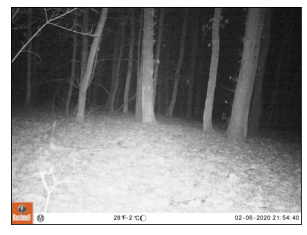

Image: 18921_02060252.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


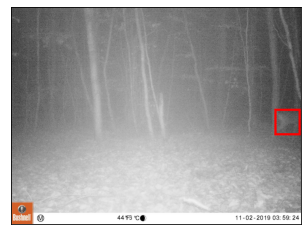

Image: 7789_11020136.JPG
True: roe_deer
Predicted: others
Confidence: 0.63


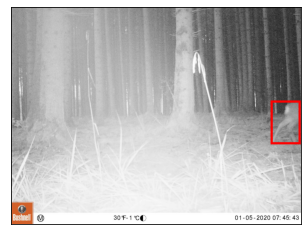

Image: 109310_01050861.JPG
True: roe_deer
Predicted: others
Confidence: 0.88


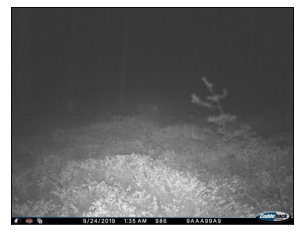

Image: 39389_I_00019b.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


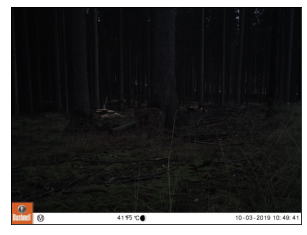

Image: 3728_10030402.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


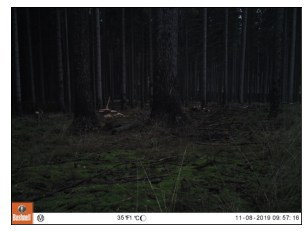

Image: 9754_11080074.JPG
True: roe_deer
Predicted: empty
Confidence: 1.00


In [82]:
random.seed(456)
true_roedeer = inspect_images(
    results=results, 
    true_label='roe_deer',
    label_map=LABEL_MAP,
    mapping_dict=MAPPING_DICT,
    detector_dict=DETECTOR_DICT,
    n_displays=70,
    img_dir=IMGDIR,
    is_misclassified=True,
    sorting='rand'
)

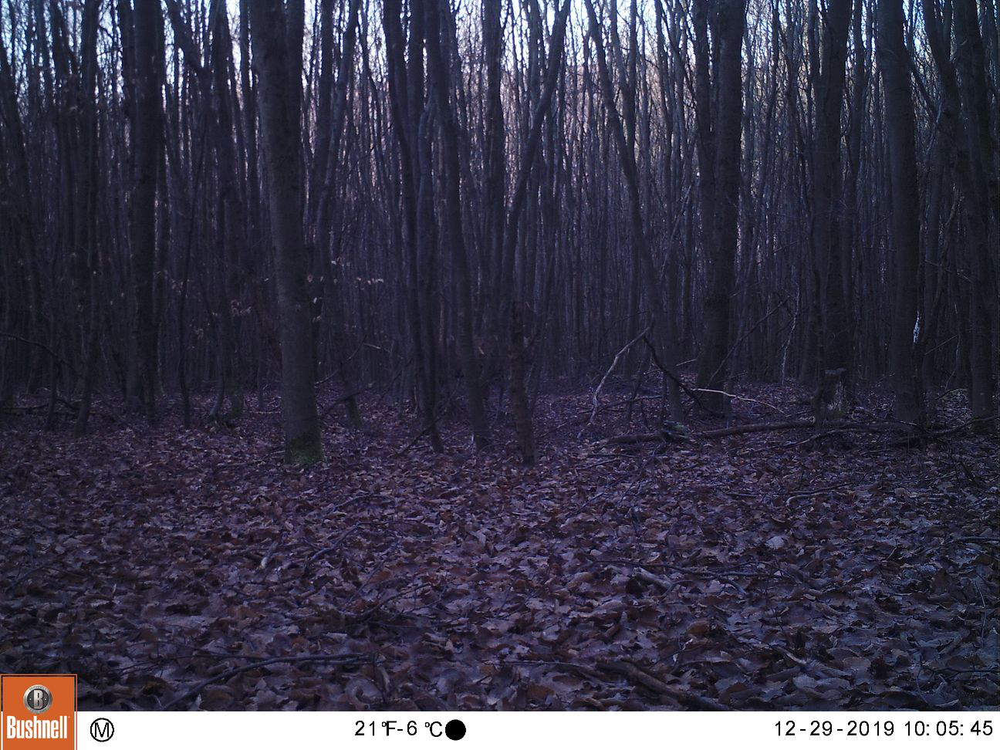

In [86]:
true_roedeer['8294_12290358.JPG'] # wrong human label (roe deer)

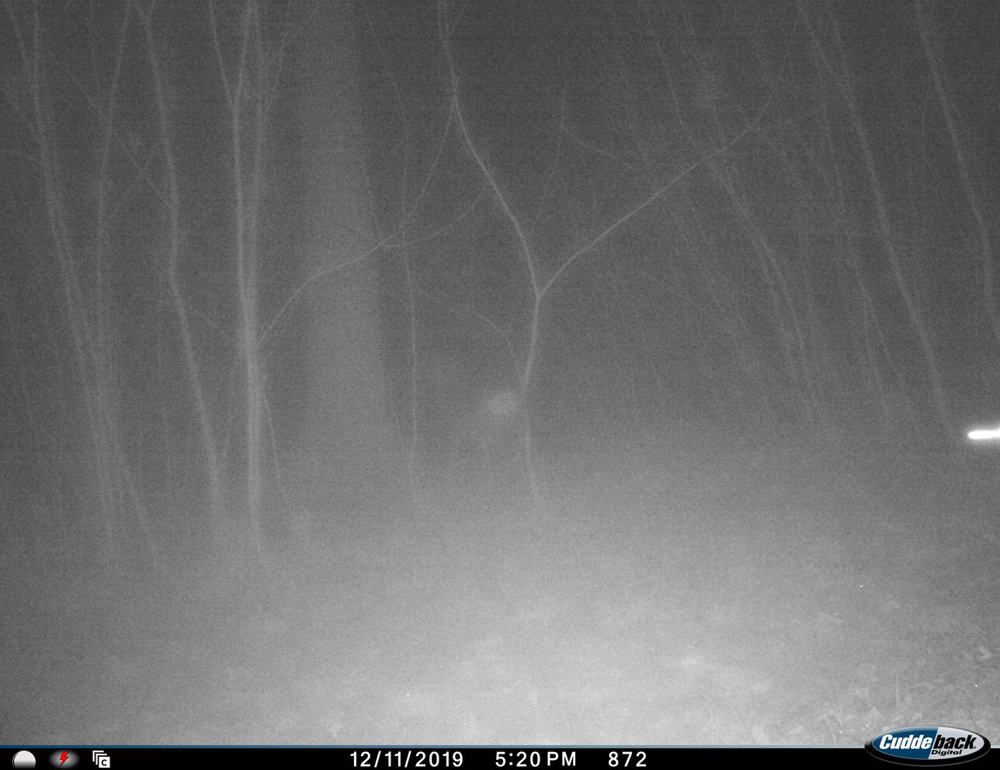

In [99]:
true_roedeer['30778_I_00104c.JPG'] # bad lighting

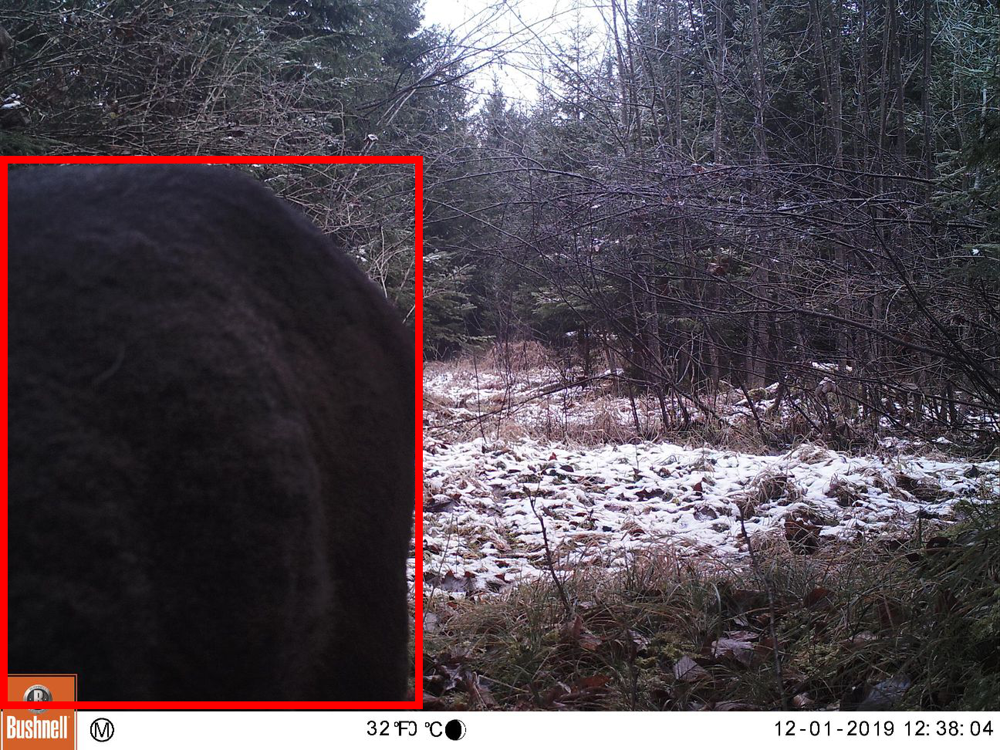

In [87]:
true_roedeer['124189_12010049.JPG'] # close-up

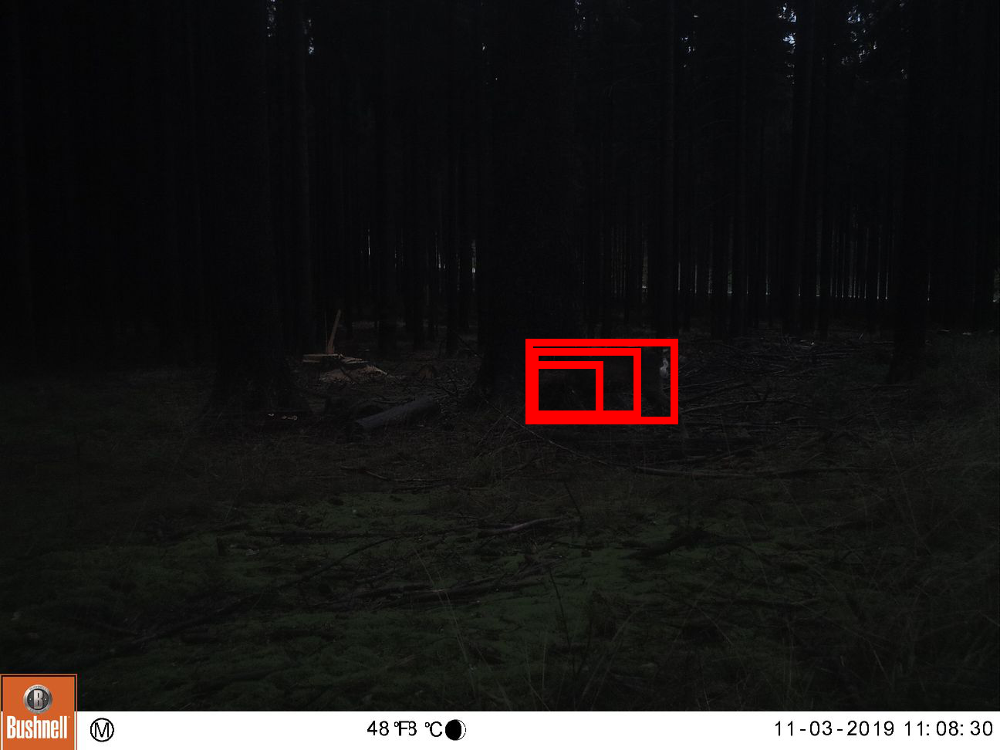

In [203]:
true_roedeer['6534_11030882.JPG'] # bad lighting

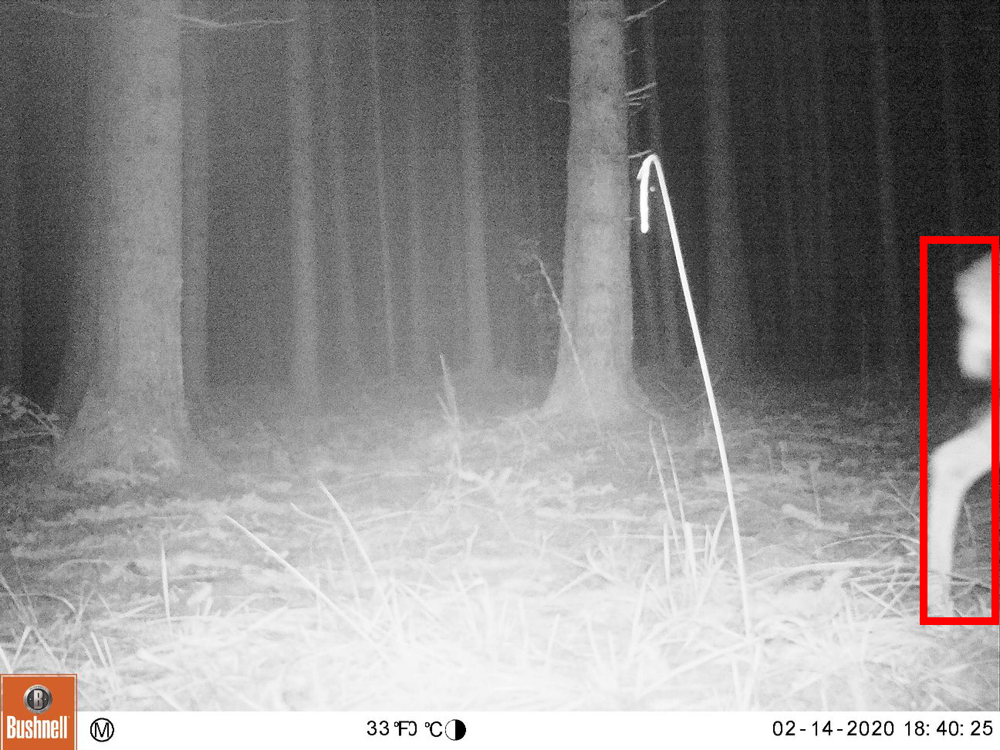

In [88]:
true_roedeer['109660_02140212.JPG'] # partial occlusion

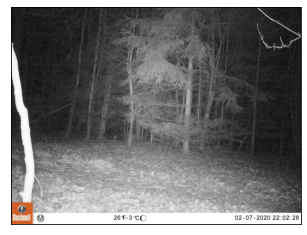

Image: 47298_02070875.JPG
True: others
Predicted: empty
Confidence: 1.00


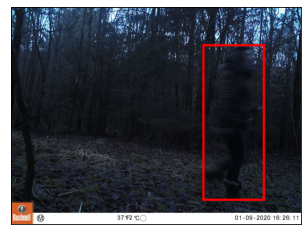

Image: 47886_01090348.JPG
True: others
Predicted: roe_deer
Confidence: 0.78


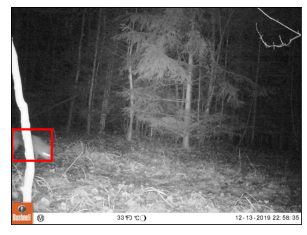

Image: 47120_12130751.JPG
True: others
Predicted: red_fox
Confidence: 0.60


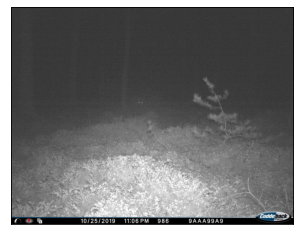

Image: 39442_I_00105c.JPG
True: others
Predicted: empty
Confidence: 1.00


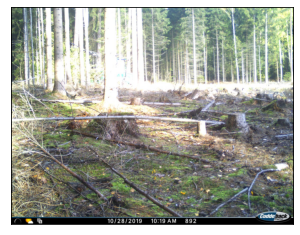

Image: 10950_I_00080b.JPG
True: others
Predicted: empty
Confidence: 1.00


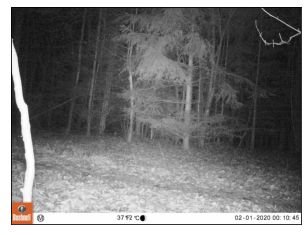

Image: 50071_02010725.JPG
True: others
Predicted: empty
Confidence: 1.00


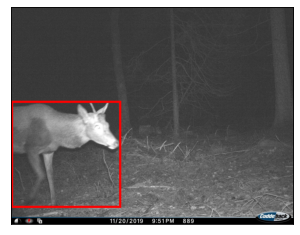

Image: 12304_I_00059a.JPG
True: others
Predicted: roe_deer
Confidence: 1.00


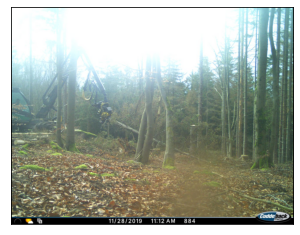

Image: 2989_I_00053b.JPG
True: others
Predicted: empty
Confidence: 1.00


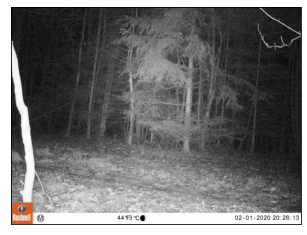

Image: 48750_02010745.JPG
True: others
Predicted: empty
Confidence: 1.00


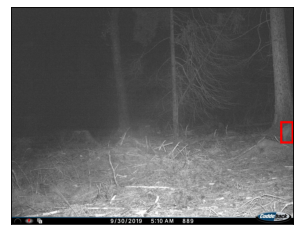

Image: 12260_I_00004c.JPG
True: others
Predicted: wild_boar
Confidence: 0.91


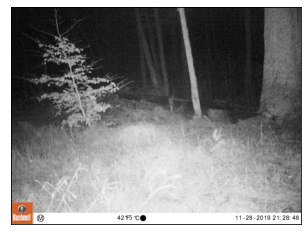

Image: 11858_11280258.JPG
True: others
Predicted: empty
Confidence: 1.00


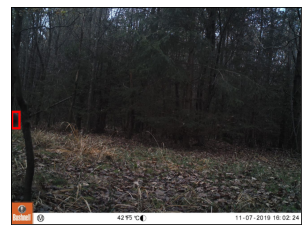

Image: 48569_11070952.JPG
True: others
Predicted: roe_deer
Confidence: 0.57


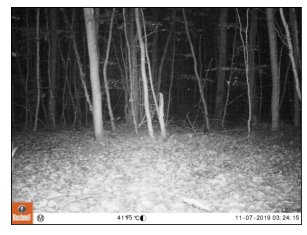

Image: 8298_11070163.JPG
True: others
Predicted: empty
Confidence: 1.00


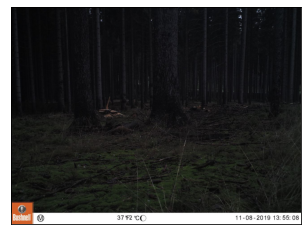

Image: 7434_11080090.JPG
True: others
Predicted: empty
Confidence: 1.00


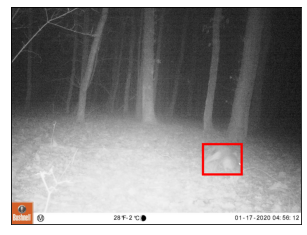

Image: 18672_01170003.JPG
True: others
Predicted: european_hare
Confidence: 0.98


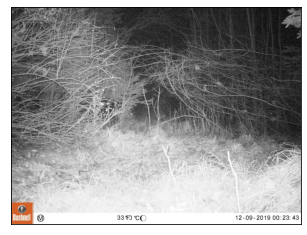

Image: 124666_12090526.JPG
True: others
Predicted: empty
Confidence: 1.00


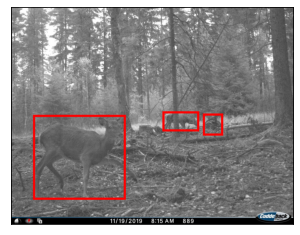

Image: 12324_I_00056a.JPG
True: others
Predicted: roe_deer
Confidence: 0.99


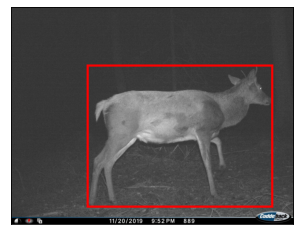

Image: 12552_I_00065a.JPG
True: others
Predicted: roe_deer
Confidence: 0.69


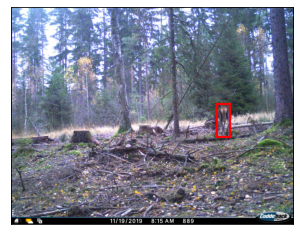

Image: 12537_I_00057c.JPG
True: others
Predicted: roe_deer
Confidence: 0.85


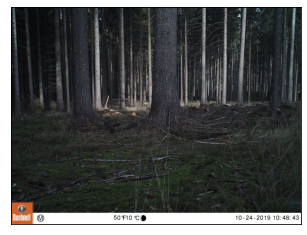

Image: 7515_10240446.JPG
True: others
Predicted: empty
Confidence: 1.00


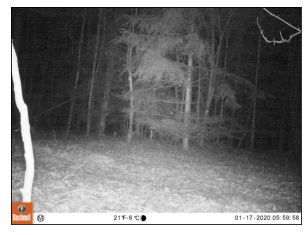

Image: 50549_01170481.JPG
True: others
Predicted: empty
Confidence: 1.00


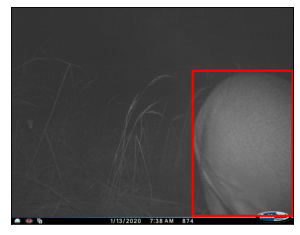

Image: 293_I_00184b.JPG
True: others
Predicted: roe_deer
Confidence: 0.98


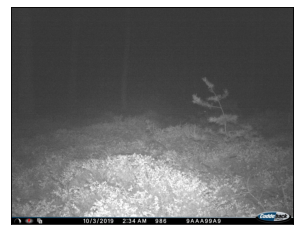

Image: 39532_I_00052b.JPG
True: others
Predicted: empty
Confidence: 1.00


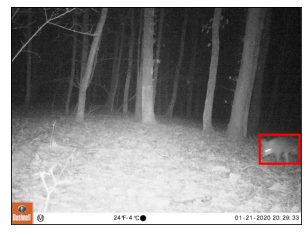

Image: 18766_01210097.JPG
True: others
Predicted: red_fox
Confidence: 0.78


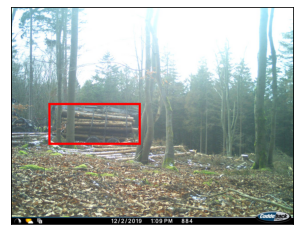

Image: 3255_I_00143c.JPG
True: others
Predicted: empty
Confidence: 0.52


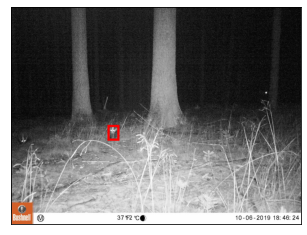

Image: 8380_10060698.JPG
True: others
Predicted: roe_deer
Confidence: 1.00


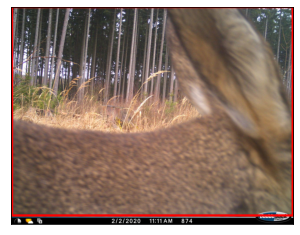

Image: 594_I_00233a.JPG
True: others
Predicted: roe_deer
Confidence: 0.99


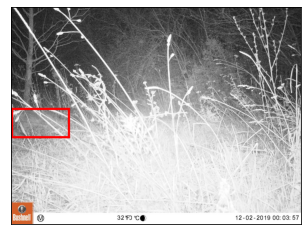

Image: 28853_12020523.JPG
True: others
Predicted: roe_deer
Confidence: 0.46


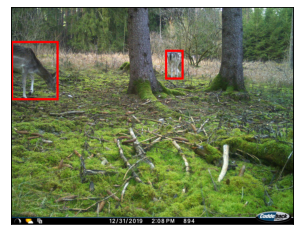

Image: 20405_I_00283b.JPG
True: others
Predicted: roe_deer
Confidence: 0.50


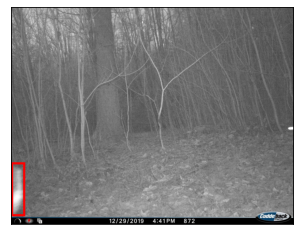

Image: 31175_I_00118c.JPG
True: others
Predicted: roe_deer
Confidence: 0.90


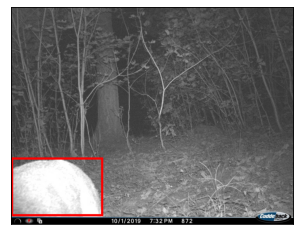

Image: 31161_I_00011a.JPG
True: others
Predicted: wild_boar
Confidence: 0.82


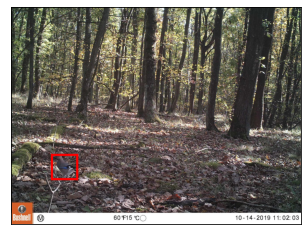

Image: 17862_10140192.JPG
True: others
Predicted: red_squirrel
Confidence: 0.43


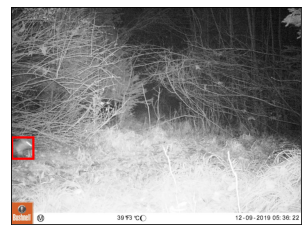

Image: 124675_12090535.JPG
True: others
Predicted: european_hare
Confidence: 0.82


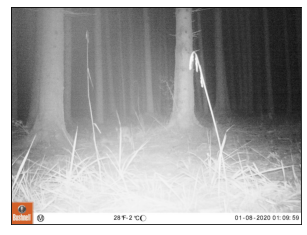

Image: 109319_01080870.JPG
True: others
Predicted: empty
Confidence: 1.00


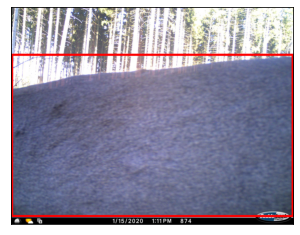

Image: 208_I_00194a.JPG
True: others
Predicted: roe_deer
Confidence: 1.00


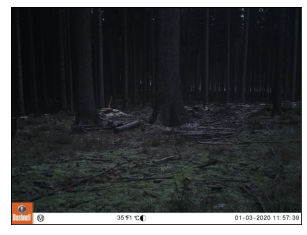

Image: 5262_01030631.JPG
True: others
Predicted: empty
Confidence: 1.00


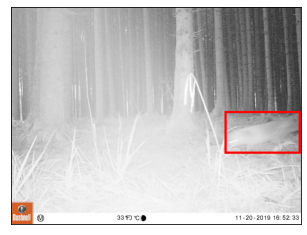

Image: 109015_11200566.JPG
True: others
Predicted: red_fox
Confidence: 1.00


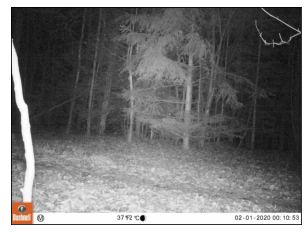

Image: 49211_02010728.JPG
True: others
Predicted: empty
Confidence: 1.00


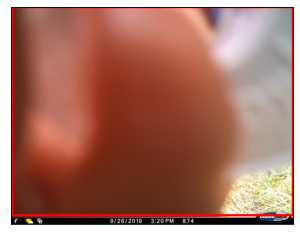

Image: 465_I_00004a.JPG
True: others
Predicted: roe_deer
Confidence: 0.88


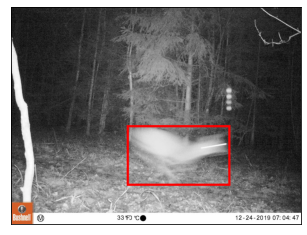

Image: 50474_12240940.JPG
True: others
Predicted: roe_deer
Confidence: 0.56


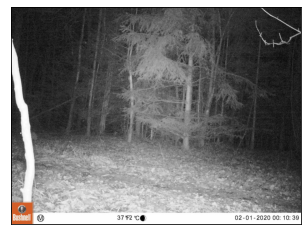

Image: 47250_02010722.JPG
True: others
Predicted: empty
Confidence: 1.00


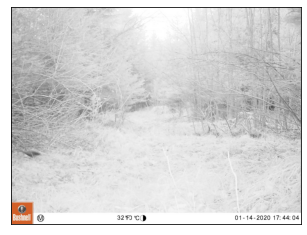

Image: 126792_01140654.JPG
True: others
Predicted: empty
Confidence: 1.00


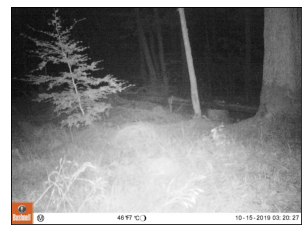

Image: 12002_10150126.JPG
True: others
Predicted: empty
Confidence: 1.00


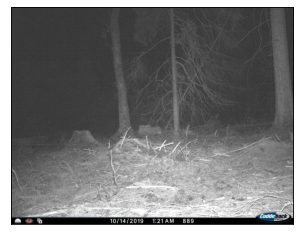

Image: 12510_I_00030a.JPG
True: others
Predicted: empty
Confidence: 1.00


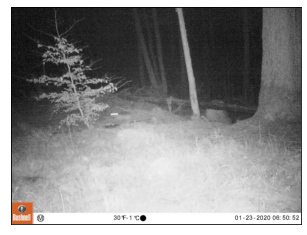

Image: 11769_01230421.JPG
True: others
Predicted: empty
Confidence: 1.00


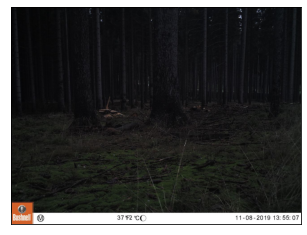

Image: 5703_11080089.JPG
True: others
Predicted: empty
Confidence: 1.00


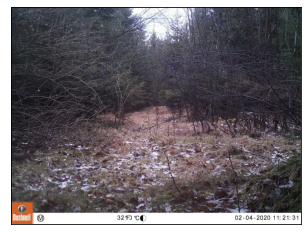

Image: 128062_02040925.JPG
True: others
Predicted: empty
Confidence: 1.00


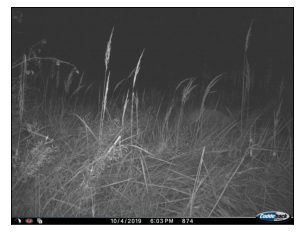

Image: 292_I_00010c.JPG
True: others
Predicted: empty
Confidence: 1.00


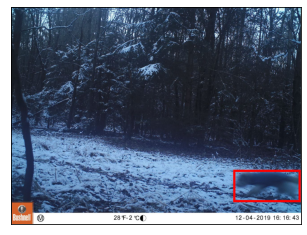

Image: 47346_12040538.JPG
True: others
Predicted: red_squirrel
Confidence: 0.98


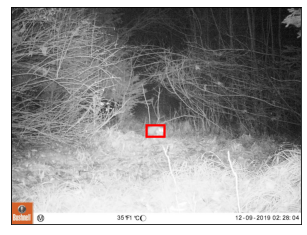

Image: 124671_12090531.JPG
True: others
Predicted: red_fox
Confidence: 1.00


In [89]:
random.seed(456)
true_others = inspect_images(
    results=results, 
    true_label='others',
    label_map=LABEL_MAP,
    mapping_dict=MAPPING_DICT,
    detector_dict=DETECTOR_DICT,
    n_displays=50,
    img_dir=IMGDIR,
    is_misclassified=True,
    sorting='rand'
)

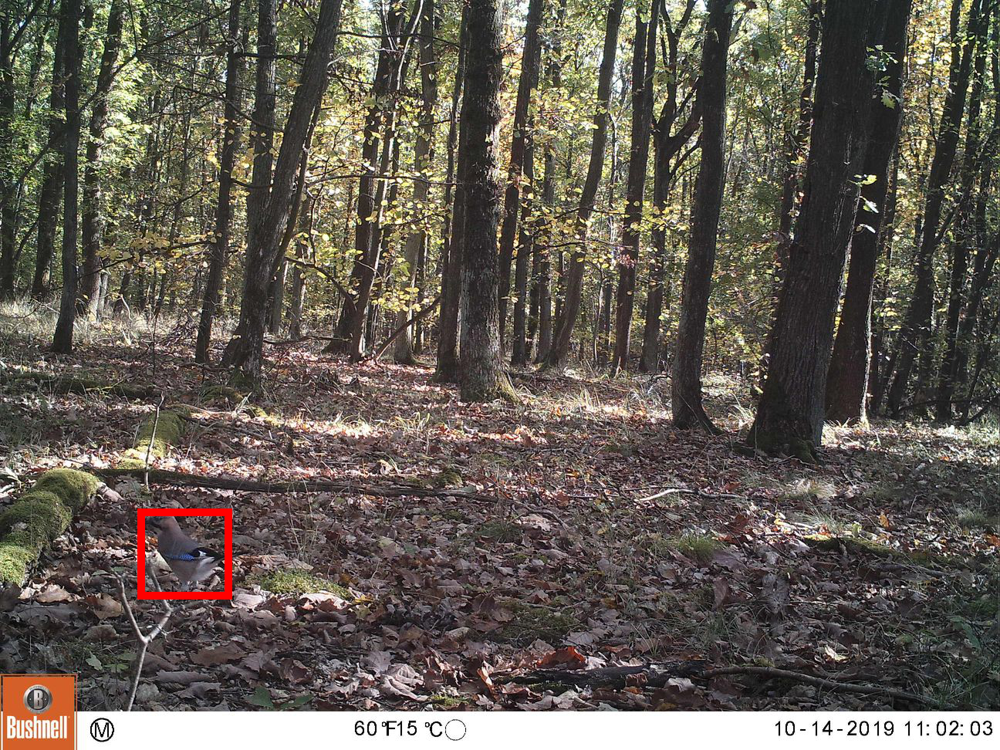

In [93]:
true_others['17862_10140192.JPG'] # small

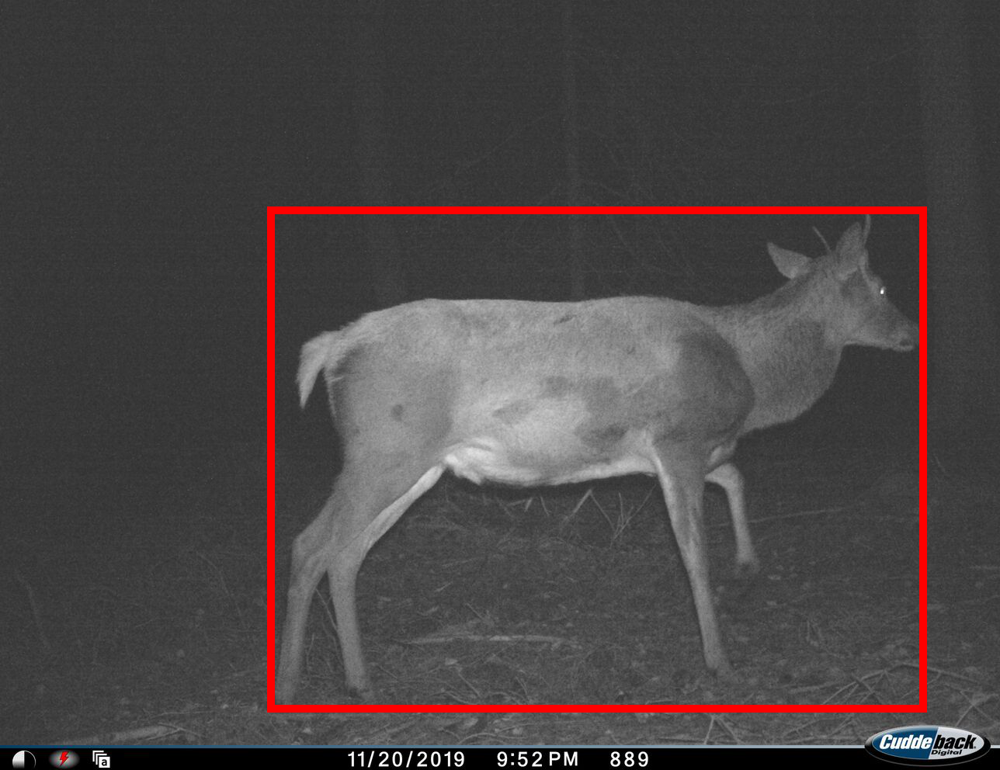

In [90]:
true_others['12552_I_00065a.JPG'] # wrong human label

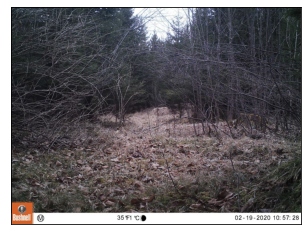

Image: 129114_02190978.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


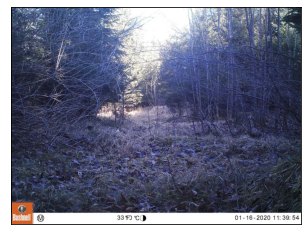

Image: 57929_01160752.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


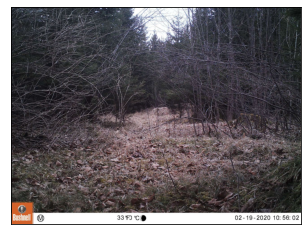

Image: 129110_02190974.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


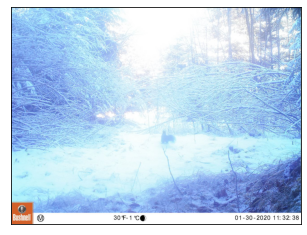

Image: 57342_01300698.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


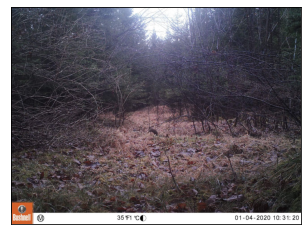

Image: 57539_01040100.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


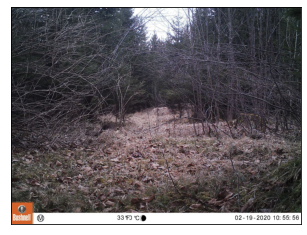

Image: 129107_02190971.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


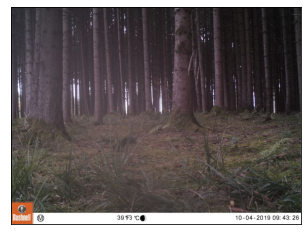

Image: 108487_10040038.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


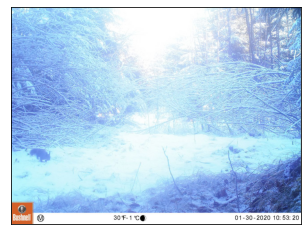

Image: 127828_01300691.JPG
True: red_squirrel
Predicted: empty
Confidence: 1.00


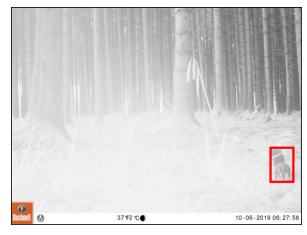

Image: 108502_10060053.JPG
True: red_squirrel
Predicted: others
Confidence: 0.58


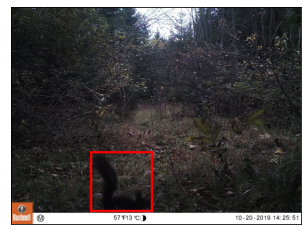

Image: 122212_10200070.JPG
True: red_squirrel
Predicted: others
Confidence: 0.57


In [92]:
random.seed(456)
true_squirrel = inspect_images(
    results=results, 
    true_label='red_squirrel',
    label_map=LABEL_MAP,
    mapping_dict=MAPPING_DICT,
    detector_dict=DETECTOR_DICT,
    n_displays=10,
    img_dir=IMGDIR,
    is_misclassified=True,
    sorting='rand'
)

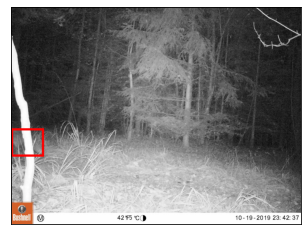

Image: 49648_10190590.JPG
True: red_fox
Predicted: others
Confidence: 0.94


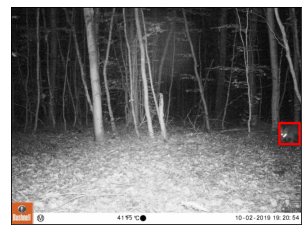

Image: 8214_10020043.JPG
True: red_fox
Predicted: roe_deer
Confidence: 0.64


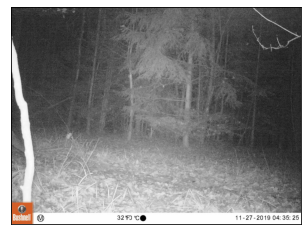

Image: 48800_11270363.JPG
True: red_fox
Predicted: empty
Confidence: 1.00


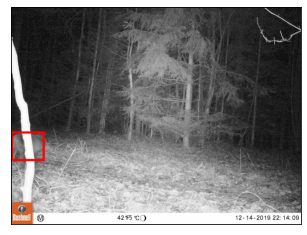

Image: 47929_12140767.JPG
True: red_fox
Predicted: others
Confidence: 0.68


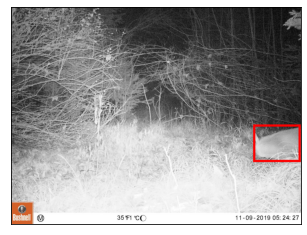

Image: 122983_11090841.JPG
True: red_fox
Predicted: european_hare
Confidence: 0.89


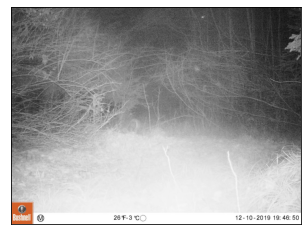

Image: 55942_12100645.JPG
True: red_fox
Predicted: empty
Confidence: 1.00


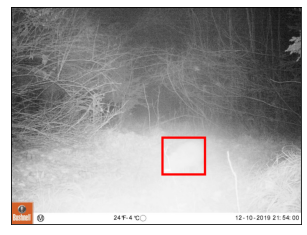

Image: 124799_12100659.JPG
True: red_fox
Predicted: european_hare
Confidence: 0.94


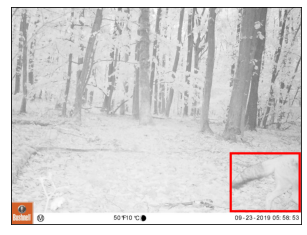

Image: 17531_09230860.JPG
True: red_fox
Predicted: others
Confidence: 0.79


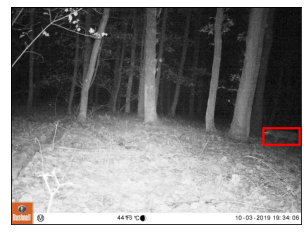

Image: 17683_10030013.JPG
True: red_fox
Predicted: roe_deer
Confidence: 0.93


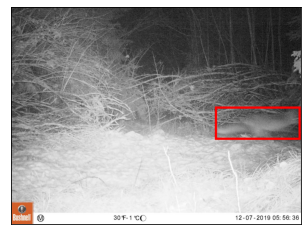

Image: 57373_12070434.JPG
True: red_fox
Predicted: others
Confidence: 0.64


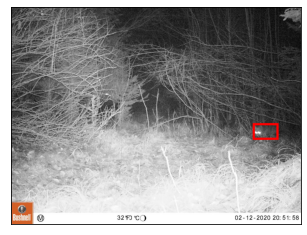

Image: 56921_02120568.JPG
True: red_fox
Predicted: european_hare
Confidence: 0.69


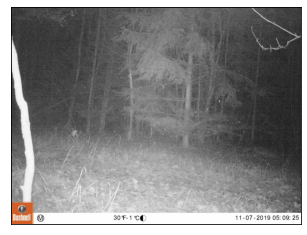

Image: 46736_11070932.JPG
True: red_fox
Predicted: empty
Confidence: 1.00


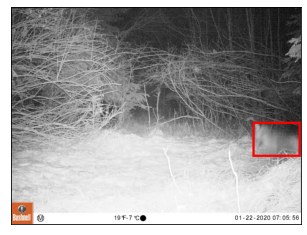

Image: 57638_01220117.JPG
True: red_fox
Predicted: others
Confidence: 0.85


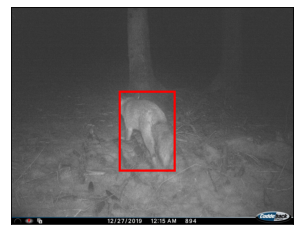

Image: 20332_I_00259a.JPG
True: red_fox
Predicted: roe_deer
Confidence: 0.67


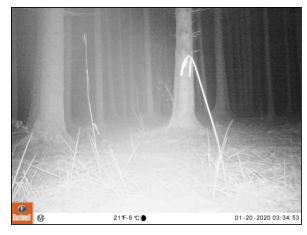

Image: 109410_01200961.JPG
True: red_fox
Predicted: empty
Confidence: 1.00


In [98]:
random.seed(456)
true_fox = inspect_images(
    results=results, 
    true_label='red_fox',
    label_map=LABEL_MAP,
    mapping_dict=MAPPING_DICT,
    detector_dict=DETECTOR_DICT,
    n_displays=15,
    img_dir=IMGDIR,
    is_misclassified=True,
    sorting='rand'
)